### Laboratorium 5 - zadania - transformacja Hougha

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

from utils import *

#### Zadanie 1

Zbadaj wpływ parametrów transformacji Hougha na jakość detekcji prostych na przykładzie obrazu `norway`. Wykorzystaj ulubiony detektor krawędzi i zaprezentuj wyniki pośrednie przed użyciem transformacji Hougha. Zapoznaj się z dokumentacją funkcji [`cv2.HoughLines`](https://docs.opencv.org/4.5.3/dd/d1a/group__imgproc__feature.html#ga46b4e588934f6c8dfd509cc6e0e4545a), zwłaszcza parametrami sterującymi rozdzielczością `rho`, `theta` oraz progiem `threshold`.

Zacznij od znalezienia odpowiednich parametrów detektora krawędzi - jeśli na tym etapie wyniki będą słabe, to dalej będzie tylko gorzej (_garbage-in, garbage-out_) - ale nie skupiaj się na badaniu ich wpływu na wyniki.

Ostateczny rezultat zaprezentuj w postaci odcinków naniesionych na kopię obrazu wejściowego (patrz komórka `[3]`).

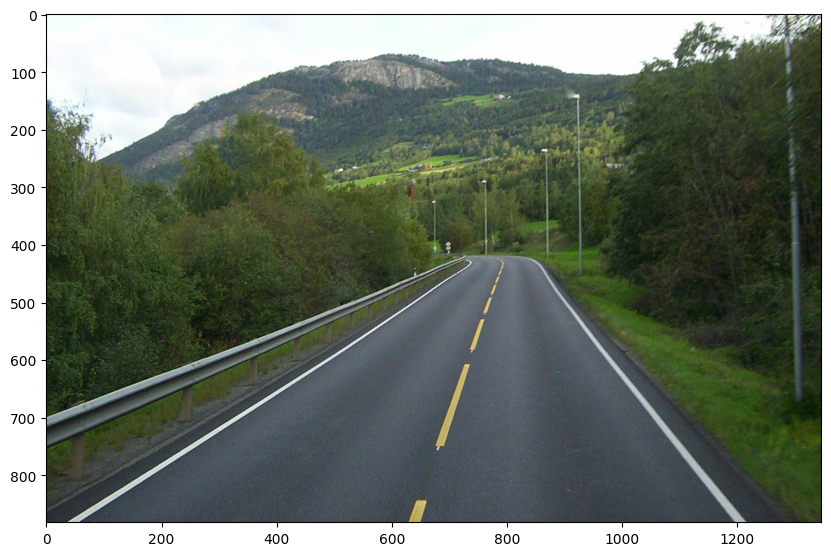

In [2]:
norway = cv2.imread('norway.jpg')
plt.subplots(1, 1, figsize=(10,10))[1].imshow(norway[..., ::-1]);

In [3]:
def rhotheta2xy(line):
    # konwersja parametrów prostej w układzie rho-theta do odcinka w układzie kartezjańskim
    # wynik można użyć jako argumenty funkcji cv2.line
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a*rho
    y0 = b*rho
    x1 = int(x0 + 5000*(-b))
    y1 = int(y0 + 5000*(a))
    x2 = int(x0 - 5000*(-b))
    y2 = int(y0 - 5000*(a))
    return x1, y1, x2, y2

Rozwiązanie:

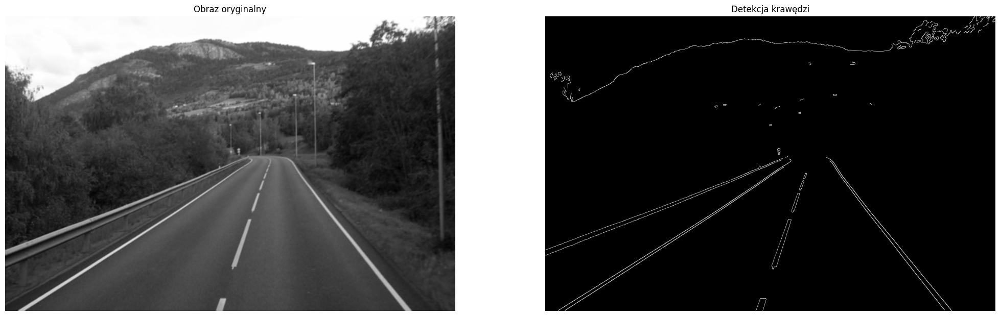

In [13]:
# Konwertuj na odcienie szarości
gray = cv2.cvtColor(norway, cv2.COLOR_BGR2GRAY)
gray = cv2.GaussianBlur(gray, (7, 7), 0)
# Zastosuj detektor krawędzi (np. Canny)
edges = cv2.Canny(gray, 150, 250)

display_images([gray, edges], ['Obraz oryginalny', 'Detekcja krawędzi'], True)

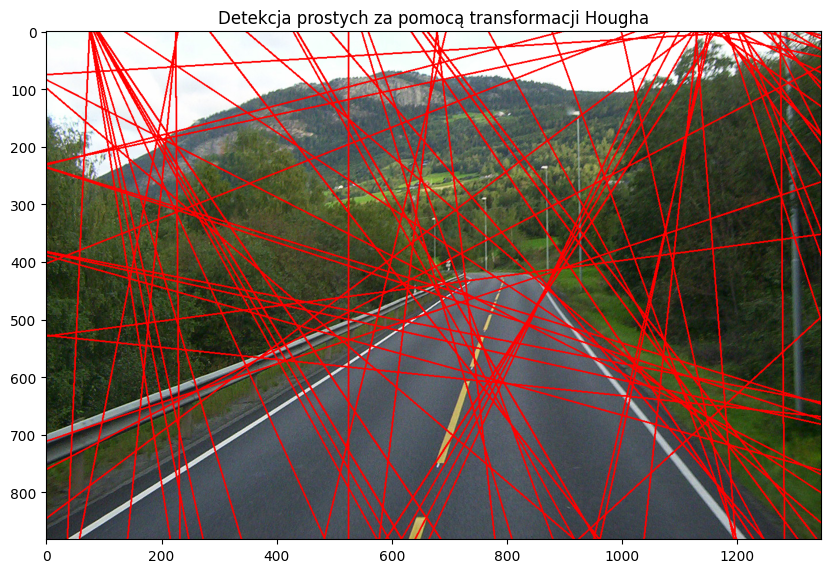

In [14]:
# Parametry transformacji Hougha
rho = 150
theta = np.pi / 360 # 
threshold = 200

# Zastosuj transformację Hougha
lines = cv2.HoughLines(edges, rho, theta, threshold)

# Wyświetl obraz z naniesionymi prostymi
norway_lines = norway.copy()
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = rhotheta2xy(line)
        cv2.line(norway_lines, (x1, y1), (x2, y2), (0, 0, 255), 2)

plt.subplots(1, 1, figsize=(10, 10))
plt.imshow(norway_lines[..., ::-1])
plt.title('Detekcja prostych za pomocą transformacji Hougha')
plt.show()


In [15]:
def plot_lines(img_edges, rho = 100, theta = np.pi / 180, threshhold = 100):
    lines = cv2.HoughLines(edges, rho, theta, threshold)
    
    norway_lines = norway.copy()
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_lines, (x1, y1), (x2, y2), (0, 0, 255), 2)
    return cv2.cvtColor(norway_lines, cv2.COLOR_BGR2RGB)

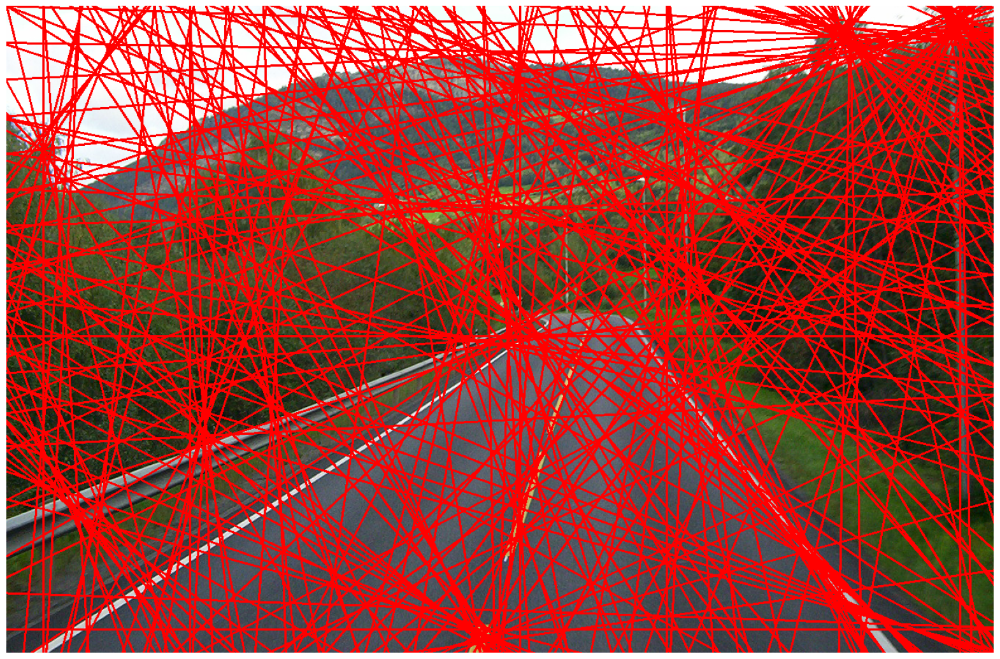

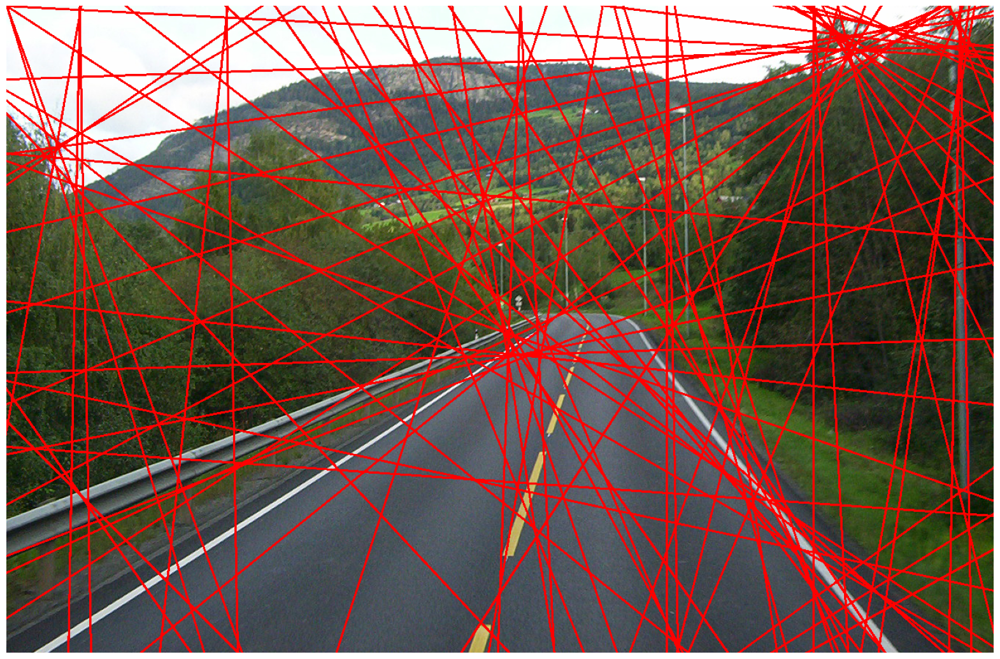

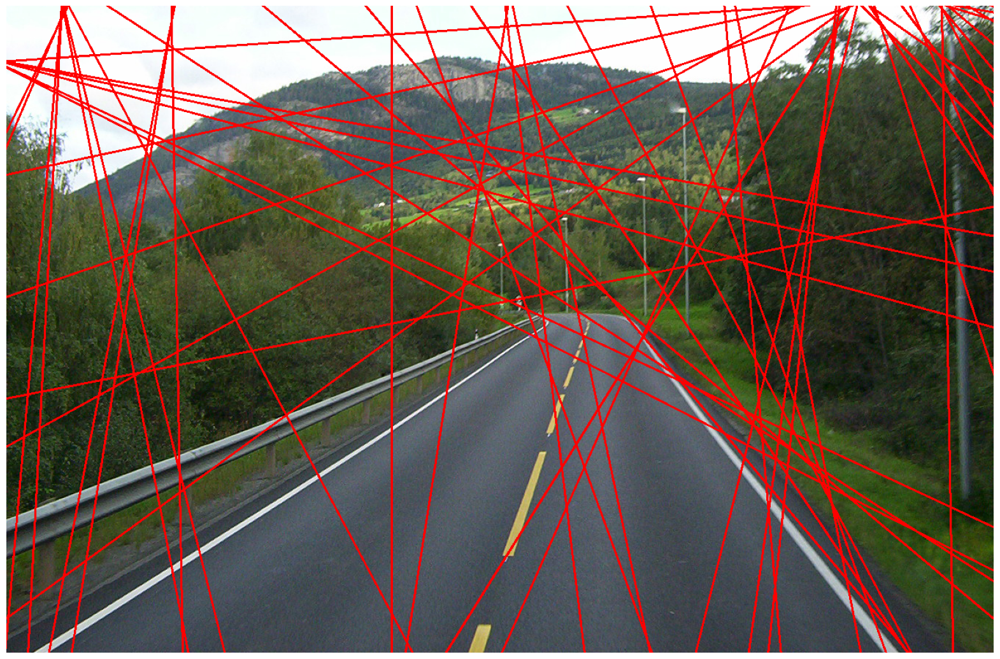

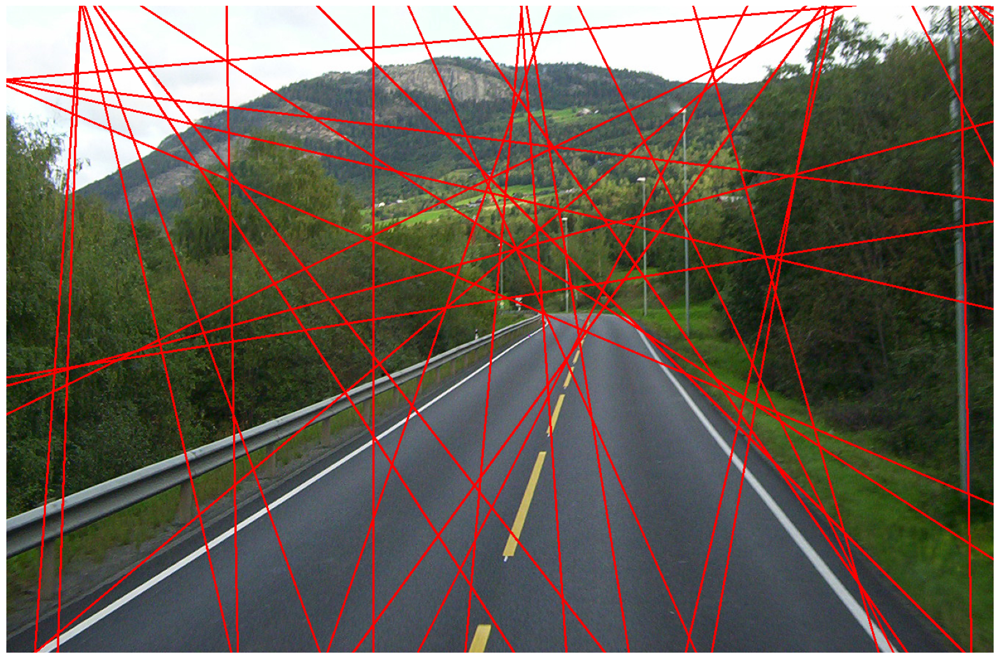

In [7]:
rho = [50, 100, 150, 200]
for r in rho:
    line = plot_lines(edges, r, np.pi / 180, 100)
    display_images([line], ['rho = ' + str(r)], True)

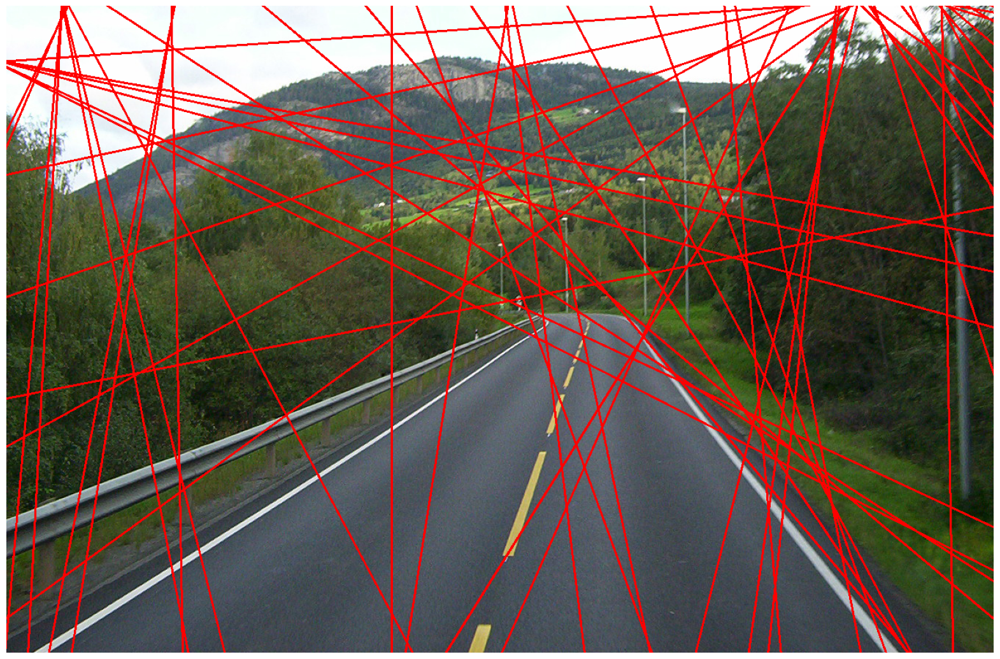

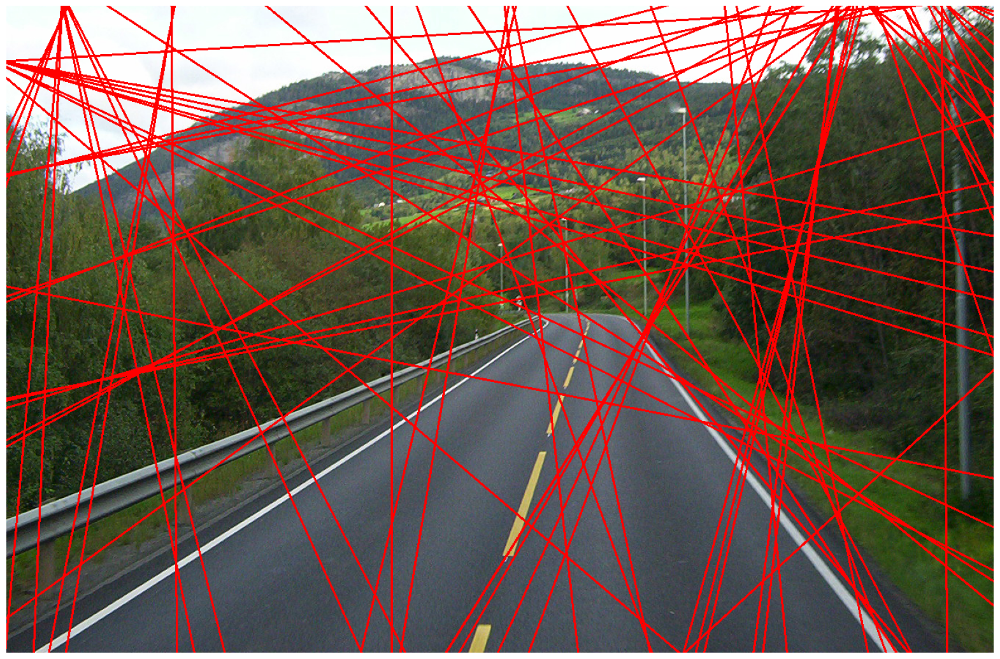

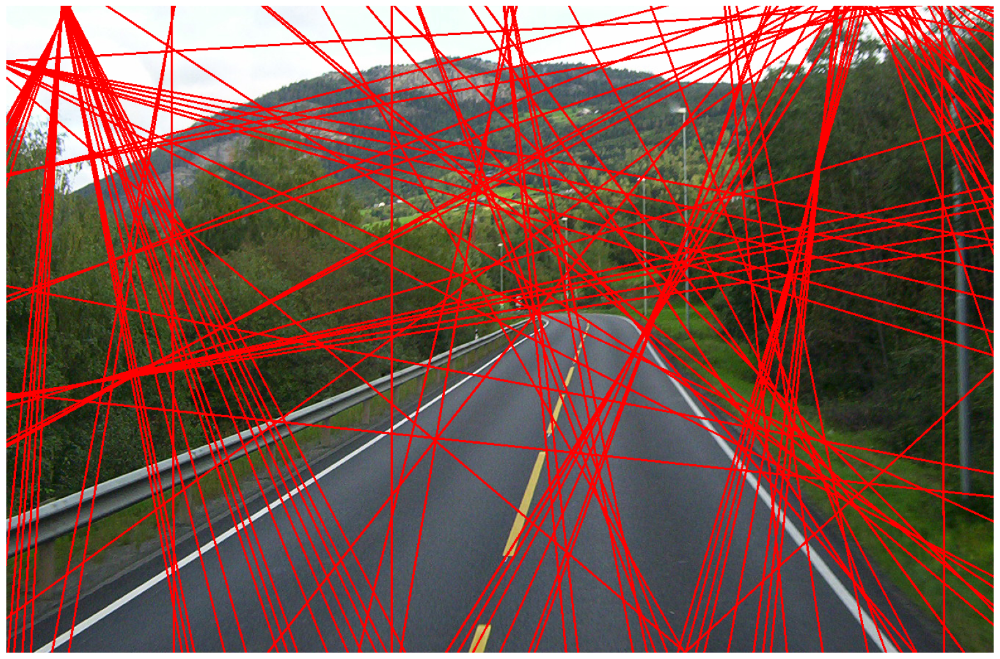

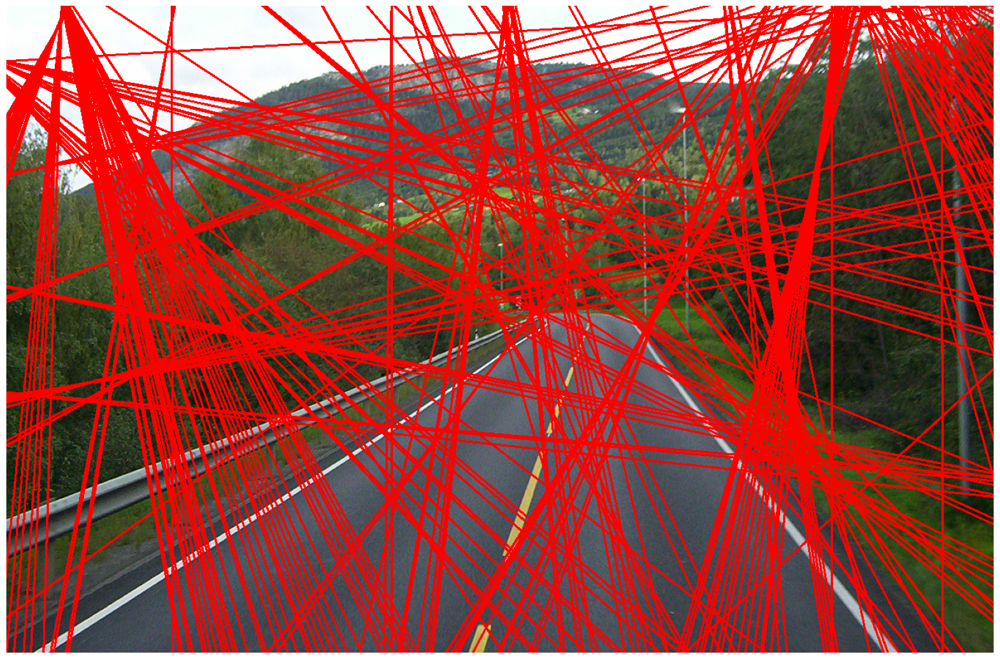

In [8]:
theta = [np.pi / 180, np.pi / 360, np.pi / 720, np.pi / 1440]
for t in theta:
    line = plot_lines(edges, 150, t, 100)
    display_images([line], ['theta = ' + str(t)], True)

In [9]:
threshold = [50, 100, 150, 200]
for t in threshold:
    line = plot_lines(edges, 150, np.pi / 180, t)
    display_images([line], ['threshold = ' + str(t)], True)

error: OpenCV(4.8.1) :-1: error: (-5:Bad argument) in function 'HoughLines'
> Overload resolution failed:
>  - Argument 'threshold' is required to be an integer
>  - Argument 'threshold' is required to be an integer


#### Zadanie 2

Dany jest obraz `pillbox`. Wykorzystaj transformację Hougha dla prostych, aby wykryć krawędzie między komórkami organizera.

Dla odmiany, w tym zadaniu nie jest istotne badanie parametrów ale wyłącznie końcowy wynik.

In [ ]:
pillbox = cv2.imread('pillbox.png')
plt.subplots(1, 1, figsize=(8,8))[1].imshow(pillbox[..., ::-1]);

Rozwiązanie: